<a href="https://colab.research.google.com/github/m4a1carbin4/2022_ML_PHW2/blob/main/Lab2_final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install pyclustering

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.6 MB 25.7 MB/s 
  Created wheel for pyclustering: filename=pyclustering-0.10.1.2-py3-none-any.whl size=2395122 sha256=4af24977349440eba075fe92c68a94f60adc2e8d7190ef14f2e93a2dbfa4502f
  Stored in directory: /root/.cache/pip/wheels/ea/87/6b/1e0568b5ba9dc6518a25338bae90bd8392f35206bb90bb10f1
Successfully built pyclustering


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import RobustScaler
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
from sklearn.cluster import DBSCAN
from pyclustering.cluster.clarans import clarans;
from pyclustering.utils import timedcall;
from sklearn import datasets
from sklearn.metrics import silhouette_score
import seaborn as sns

plt.style.use('classic')
%matplotlib inline

sns.set()

# Show all columns
pd.set_option('display.max_columns', None)

# Read the data
data = pd.read_csv('housing.csv')

In [ ]:
# Cleaning
def Cleaning_data(df):
    print(df.shape)
    print('\n *** Original Dataset')
    print(df.head())

    # The number of missing value
    print('\n *** The number of missing value')
    print(df.isnull().sum())

    # Dealing with the missing values
    print('\n *** The number of missing values after ddealing missing values')
    bedroom_median = df['total_bedrooms'].median()
    df['total_bedrooms'].fillna(bedroom_median, inplace=True)
    print(df.isnull().sum())

    # Show the original data
    df.hist(bins=25, figsize=(14, 8))
    plt.show()

    return df


# Encoding
def Encoder(data, case, index) :
    target_index = data.loc[:, index]
    #print(target_index)
    if (case == 1):
        label_encoder = LabelEncoder()
        data.loc[:, index] = label_encoder.fit_transform(target_index)
        print('\n *** After Label Encoding')
        print(data.head())
        return data
    elif (case == 2):
        data = pd.get_dummies(data, prefix=None)
        print('\n *** After Get_Dummies Encoding')
        print(data.head())
        return data
    elif (case == 3):
        OHE = OneHotEncoder(sparse=False)
        ohe_data = OHE.fit_transform(target_index)
        # Since the result converted using OneHotEncoder is numpy.array, it is necessary to convert it to a data frame
        ohe_data2 = pd.DataFrame(ohe_data, columns=['ocean_proximity_' + col for col in OHE.categories_[0]])
        data = data.drop(columns=['ocean_proximity'])
        data = pd.concat([data, ohe_data2], axis=1)
        print('\n *** After One Hot Encoding')
        print(data.head())
        return data
    else:
        print('\n *** case error')

# Scaler
def Scaler(data, case) :

    # Split the data
    X = data.drop(columns=['median_house_value'])
    y = data["median_house_value"]
    x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # Plot the data before scaling
    plt.hist(x_train, bins=30, alpha=0.7)
    plt.title('before data scaling')
    plt.show()

    if (case == 1):
        standard_scaler = StandardScaler()
        x_train_scaled = standard_scaler.fit_transform(x_train)
        x_test_scaled = standard_scaler.fit_transform(x_test)

        x_train_scaled_ss = x_train_scaled.reshape(148608, 1)
        plt.hist(x_train_scaled_ss, bins=30, alpha=0.7, density=True)
        plt.title('StandardScaler')
        plt.show()

    elif (case == 2) :
        minmax_scaler = MinMaxScaler()
        x_train_scaled = minmax_scaler.fit_transform(x_train)
        x_test_scaled = minmax_scaler.fit_transform(x_test)

        x_train_scaled_mms = x_train_scaled.reshape(148608, 1)
        plt.hist(x_train_scaled_mms, bins=30, alpha=0.7, density=True)
        plt.title('MinMaxScaler')
        plt.show()

    elif (case == 3) :
        robust_scaler = RobustScaler()
        x_train_scaled = robust_scaler.fit_transform(x_train)
        x_test_scaled = robust_scaler.fit_transform(x_test)

        x_train_scaled_rbs = x_train_scaled.reshape(148608, 1)
        plt.hist(x_train_scaled_rbs, bins=30, alpha=0.7, density=True)
        plt.title('RobustScaler')
        plt.show()

    else:
        print('\n *** case error')

In [ ]:
#function for make cluster model (K = cluster_num,data = dataset, case = switch value, kwargs = python dictionaly for cluster model parameter)
def Make_model(K,data,case,**kwargs):
    if(case == 0): #make KMeans
        model = KMeans(n_clusters=K,init=kwargs.get("init",'k-means++')
                                    ,n_init=kwargs.get('n_init',10)
                                    ,max_iter=kwargs.get('max_iter',300)
                                    ,tol=kwargs.get('tol',1e-4)
                                    ,verbose=kwargs.get('verbose',0)
                                    ,random_state=kwargs.get('random_state',None)
                                    ,copy_x=kwargs.get('copy_x',True)
                                    ,algorithm=kwargs.get('algorithm','auto'))
        #call model train function
        model_train(data,model,case,[])
    elif(case == 1): #make EM (GMM)
        model = GaussianMixture(n_components=K,covariance_type=kwargs.get('covariance_type','full')
                                            ,tol = kwargs.get('tol',1e-3)
                                            ,reg_covar=kwargs.get('reg_covar',1e-6)
                                            ,max_iter=kwargs.get('max_iter',100)
                                            ,n_init=kwargs.get('n_init',1)
                                            ,init_params=kwargs.get('init_params','kmeans')
                                            ,weights_init=kwargs.get('weights_init',None)
                                            ,means_init=kwargs.get('means_init',None)
                                            ,precisions_init=kwargs.get('precisions_init',None)
                                            ,random_state=kwargs.get('random_state',None)
                                            ,warm_start=kwargs.get('warm_start',False)
                                            ,verbose=kwargs.get('verbose',0)
                                            ,verbose_interval=kwargs.get('verbose_interval',10))
        #call model train function
        model_train(data,model,case,[])
    elif(case == 2): #make CLARANS (failed)
        name = data.columns.values.tolist()
        print(name)

        name.append('labels')

        print(name)

        data = data.values.tolist()

        model = clarans(data
                        ,number_clusters=K
                        ,numlocal=kwargs.get('numlocal',6)
                        ,maxneighbor=kwargs.get('maxneighbor',4))
        
        (ticks, result) = timedcall(model.process);
        print("Execution time : ", ticks, "\n");


        #call model train function
        model_train(data,model,case,name)

    elif(case == 3): #make DBSCAN
        model = DBSCAN(eps=kwargs.get('eps',0.5)
                        ,min_samples=kwargs.get('min_samples',5)
                        ,metric=kwargs.get('metric','euclidean')
                        ,metric_params=kwargs.get('metric_params',None)
                        ,algorithm=kwargs.get('algorithm','auto')
                        ,leaf_size=kwargs.get('leaf_size',30)
                        ,p=kwargs.get('p',None)
                        ,n_jobs=kwargs.get('n_jobs',None))
        #call model train function
        model_train(data,model,case,[])

    else:
        print('case error! (1~4)')

#function for model train (data = dataset, model = clustering model object, case = switch value)
def model_train(data,model,case,name):
    if(case == 0): # train KMeans
        model.fit_predict(data)

        labels = pd.DataFrame(model.labels_)
        labeleddata = pd.concat((data,labels),axis=1)
        labeleddata = labeleddata.rename({0:'labels'},axis=1)

        # draw clustering result plot
        sns.pairplot(labeleddata,hue='labels')

        # check silhouette_score
        score = silhouette_score(data,labels)

        print("silhouette_score : ")
        print(score) 

        #Compare clustering result with N (2,4,6,8,10) quantiles of medianHouseValue
        draw_median_test(labeleddata)

    elif(case == 1): # Train EM(GMM)
        lables = model.fit_predict(data)

        labels = pd.DataFrame(lables)
        labeleddata = pd.concat((data,labels),axis=1)
        labeleddata = labeleddata.rename({0:'labels'},axis=1)

        # draw clustering result plot
        sns.pairplot(labeleddata,hue='labels')

        # check silhouette_score
        score = silhouette_score(data,labels)
        print("silhouette_score : ")
        print(score)

        #Compare clustering result with N (2,4,6,8,10) quantiles of medianHouseValue
        draw_median_test(labeleddata)

    elif(case == 2): # Train CLARANS (FAILED)
        #returns the clusters 
        clusters = model.get_clusters();

        #returns the mediods 
        medoids = model.get_medoids();

        print("Index of the points that are in a cluster : ",clusters)
        print("The index of medoids that algorithm found to be best : ",medoids)

        #make New Result DataFrame
        result = []
        label = 0

        for a in clusters:
          for index in a:
            data[index].append(label)
            result.append(data[index])
          label = label+1

        result = pd.DataFrame(result)

        result.columns = name

        print(result.columns)
        
        # draw clustering result plot
        sns.pairplot(result,hue='labels')
        
        #Compare clustering result with N (2,4,6,8,10) quantiles of medianHouseValue
        draw_median_test(result)

    elif(case == 3): # Train DBSCAN
        lables = model.fit_predict(data)

        labels = pd.DataFrame(lables)
        labeleddata = pd.concat((data,labels),axis=1)
        labeleddata = labeleddata.rename({0:'labels'},axis=1)

        # draw clustering result plot
        sns.pairplot(labeleddata,hue='labels')

        # check silhouette_score
        score = silhouette_score(data,labels)
        print("silhouette_score : ")
        print(score)

        #Compare clustering result with N (2,4,6,8,10) quantiles of medianHouseValue
        draw_median_test(labeleddata)

    else:
        print('case error! (1~4)')

#function for draw Compare plot with N (2,4,6,8,10) quantiles of medianHouseValue
def draw_median_test(labeleddata):

        house_value = labeleddata['median_house_value']

        tmp = house_value.quantile(q=0.5)

        for id in labeleddata:

            labeleddata.plot.scatter(x='median_house_value',y=id,c='labels',colormap='viridis')
            plt.axvline(tmp,0,1,color='lightgray', linestyle='--', linewidth=2)
            plt.show()

        tmp1 = house_value.quantile(q=0.25)
        tmp2 = house_value.quantile(q=0.5)
        tmp3 = house_value.quantile(q=0.75)

        for id in labeleddata:

            labeleddata.plot.scatter(x='median_house_value',y=id,c='labels',colormap='viridis')
            plt.axvline(tmp1,0,1,color='lightgray', linestyle='--', linewidth=2)
            plt.axvline(tmp2,0,1,color='lightgray', linestyle='--', linewidth=2)
            plt.axvline(tmp3,0,1,color='lightgray', linestyle='--', linewidth=2)
            plt.show()

        tmp1 = house_value.quantile(q=0.16)
        tmp2 = house_value.quantile(q=0.32)
        tmp3 = house_value.quantile(q=0.48)
        tmp4 = house_value.quantile(q=0.64)
        tmp5 = house_value.quantile(q=0.70)

        for id in labeleddata:

            labeleddata.plot.scatter(x='median_house_value',y=id,c='labels',colormap='viridis')
            plt.axvline(tmp1,0,1,color='lightgray', linestyle='--', linewidth=2)
            plt.axvline(tmp2,0,1,color='lightgray', linestyle='--', linewidth=2)
            plt.axvline(tmp3,0,1,color='lightgray', linestyle='--', linewidth=2)
            plt.axvline(tmp4,0,1,color='lightgray', linestyle='--', linewidth=2)
            plt.axvline(tmp5,0,1,color='lightgray', linestyle='--', linewidth=2)
            plt.show()
        
        tmp1 = house_value.quantile(q=0.125)
        tmp2 = house_value.quantile(q=0.250)
        tmp3 = house_value.quantile(q=0.375)
        tmp4 = house_value.quantile(q=0.500)
        tmp5 = house_value.quantile(q=0.625)
        tmp6 = house_value.quantile(q=0.750)
        tmp7 = house_value.quantile(q=0.875)

        for id in labeleddata:

            labeleddata.plot.scatter(x='median_house_value',y=id,c='labels',colormap='viridis')
            plt.axvline(tmp1,0,1,color='lightgray', linestyle='--', linewidth=2)
            plt.axvline(tmp2,0,1,color='lightgray', linestyle='--', linewidth=2)
            plt.axvline(tmp3,0,1,color='lightgray', linestyle='--', linewidth=2)
            plt.axvline(tmp4,0,1,color='lightgray', linestyle='--', linewidth=2)
            plt.axvline(tmp5,0,1,color='lightgray', linestyle='--', linewidth=2)
            plt.axvline(tmp6,0,1,color='lightgray', linestyle='--', linewidth=2)
            plt.axvline(tmp7,0,1,color='lightgray', linestyle='--', linewidth=2)
            plt.show()

        tmp1 = house_value.quantile(q=0.1)
        tmp2 = house_value.quantile(q=0.2)
        tmp3 = house_value.quantile(q=0.3)
        tmp4 = house_value.quantile(q=0.4)
        tmp5 = house_value.quantile(q=0.5)
        tmp6 = house_value.quantile(q=0.6)
        tmp7 = house_value.quantile(q=0.7)
        tmp8 = house_value.quantile(q=0.8)
        tmp9 = house_value.quantile(q=0.9)

        for id in labeleddata:

            labeleddata.plot.scatter(x='median_house_value',y=id,c='labels',colormap='viridis')
            plt.axvline(tmp1,0,1,color='lightgray', linestyle='--', linewidth=2)
            plt.axvline(tmp2,0,1,color='lightgray', linestyle='--', linewidth=2)
            plt.axvline(tmp3,0,1,color='lightgray', linestyle='--', linewidth=2)
            plt.axvline(tmp4,0,1,color='lightgray', linestyle='--', linewidth=2)
            plt.axvline(tmp5,0,1,color='lightgray', linestyle='--', linewidth=2)
            plt.axvline(tmp6,0,1,color='lightgray', linestyle='--', linewidth=2)
            plt.axvline(tmp7,0,1,color='lightgray', linestyle='--', linewidth=2)
            plt.axvline(tmp8,0,1,color='lightgray', linestyle='--', linewidth=2)
            plt.axvline(tmp9,0,1,color='lightgray', linestyle='--', linewidth=2)
            plt.show()

(15210, 10)

 *** Original Dataset
   longitude  latitude  housing_median_age  total_rooms  total_bedrooms  \
0    -122.23     37.88                41.0        880.0           129.0   
1    -122.22     37.86                21.0       7099.0          1106.0   
2    -122.24     37.85                52.0       1467.0           190.0   
3    -122.25     37.85                52.0       1274.0           235.0   
4    -122.25     37.85                52.0       1627.0           280.0   

   population  households  median_income  median_house_value ocean_proximity  
0       322.0       126.0         8.3252            452600.0        NEAR BAY  
1      2401.0      1138.0         8.3014            358500.0        NEAR BAY  
2       496.0       177.0         7.2574            352100.0        NEAR BAY  
3       558.0       219.0         5.6431            341300.0        NEAR BAY  
4       565.0       259.0         3.8462            342200.0        NEAR BAY  

 *** The number of missing value
longit

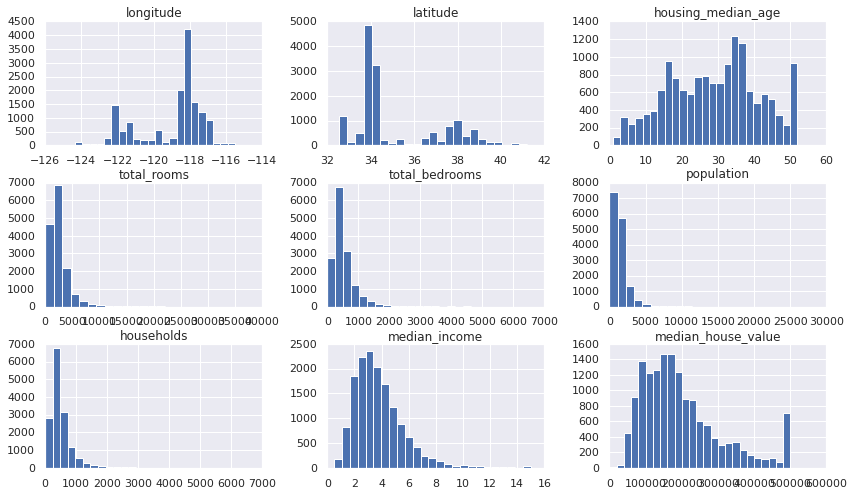


 *** After Label Encoding
   longitude  latitude  housing_median_age  total_rooms  total_bedrooms  \
0    -122.23     37.88                41.0        880.0           129.0   
1    -122.22     37.86                21.0       7099.0          1106.0   
2    -122.24     37.85                52.0       1467.0           190.0   
3    -122.25     37.85                52.0       1274.0           235.0   
4    -122.25     37.85                52.0       1627.0           280.0   

   population  households  median_income  median_house_value  ocean_proximity  
0       322.0       126.0         8.3252            452600.0                3  
1      2401.0      1138.0         8.3014            358500.0                3  
2       496.0       177.0         7.2574            352100.0                3  
3       558.0       219.0         5.6431            341300.0                3  
4       565.0       259.0         3.8462            342200.0                3  

 *** After Get_Dummies Encoding
   longit

/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:115: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


TypeError: ignored

In [ ]:
# Call Cleander
cleanded_data = Cleaning_data(data)

# Call Encoder
df1 = cleanded_data.copy()
df2 = cleanded_data.copy()
df3 = cleanded_data.copy()
list1 = ['ocean_proximity']

# Save encoded data
encoded_data1 = Encoder(df1, 1, list1)
encoded_data2 = Encoder(df2, 2, list1)
encoded_data3 = Encoder(df3, 3, list1)

# Call Scaler
Scaler(encoded_data1, 1)
Scaler(encoded_data1, 2)
Scaler(encoded_data1, 3)

['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'median_house_value', 'ocean_proximity']
['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'median_house_value', 'ocean_proximity', 'labels']
Execution time :  144.2027086199996 

Index of the points that are in a cluster :  [[5, 9, 100, 106, 107, 110, 112, 150, 152, 162, 227, 232, 274, 359, 364, 386, 391, 398, 399, 400, 414, 428, 429, 451, 485, 486, 542, 549, 565, 572, 579, 585, 590, 592, 593, 596, 613, 628, 641, 663, 754, 838, 843, 853, 865, 868, 880, 883, 892, 907, 909, 916, 925, 960, 961, 962, 963, 1005, 1015, 1271, 1279, 1391, 1399, 1413, 1450, 1467, 1469, 1470, 1494, 1495, 1506, 1517, 1520, 1521, 1525, 1528, 1529, 1532, 1542, 1543, 1547, 1548, 1572, 1600, 1610, 1664, 1690, 1792, 1817, 1819, 1824, 1840, 1841, 2198, 3379, 3380, 3384, 3389, 3467, 3526, 3527, 3537, 3540, 3541, 3546, 35

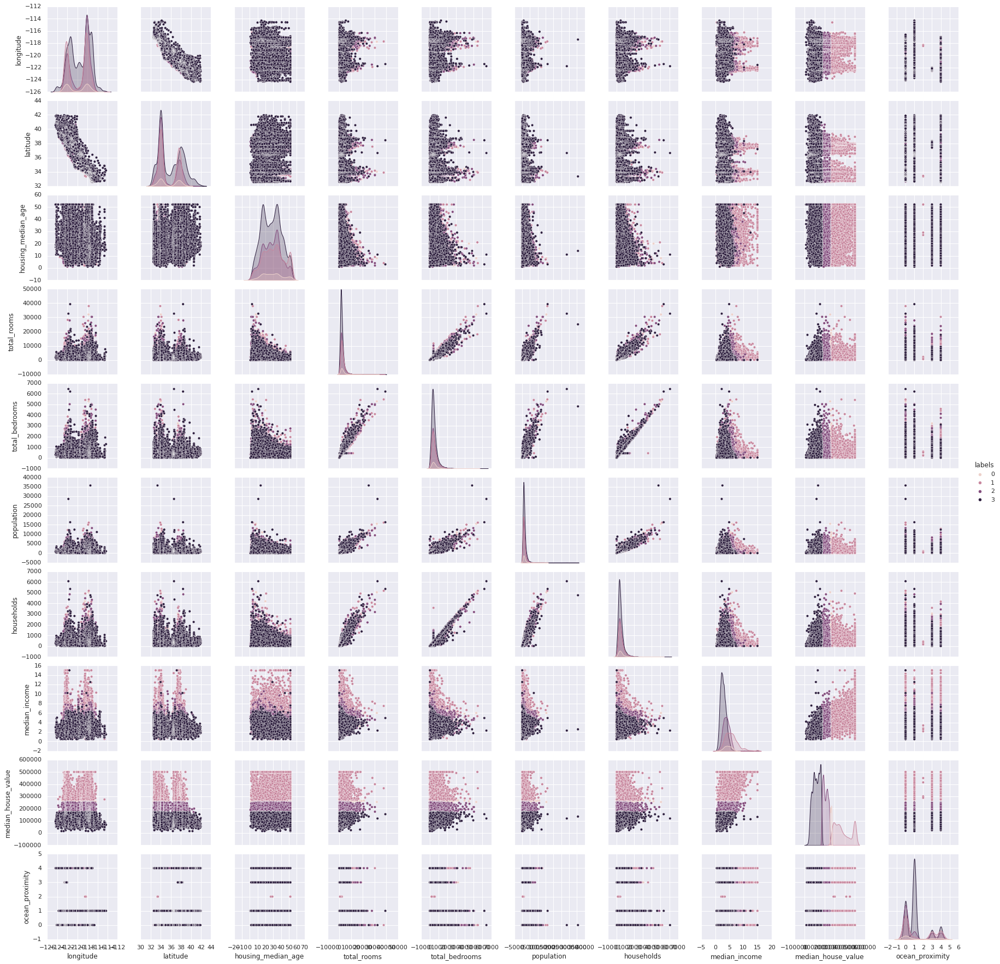

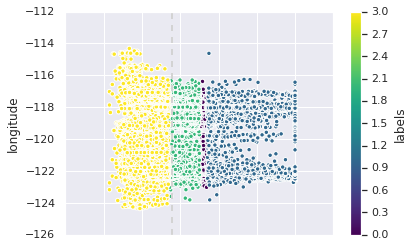

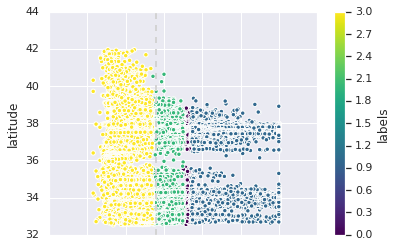

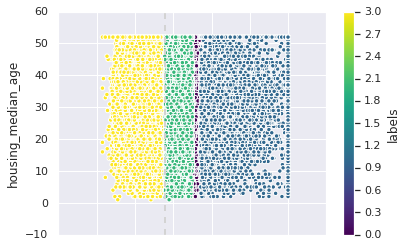

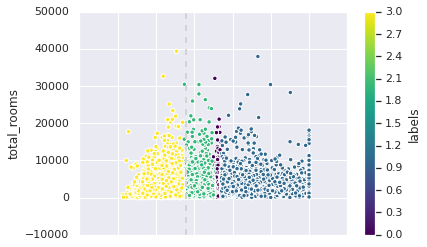

...

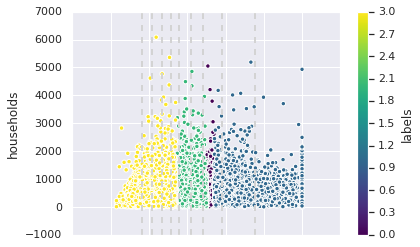

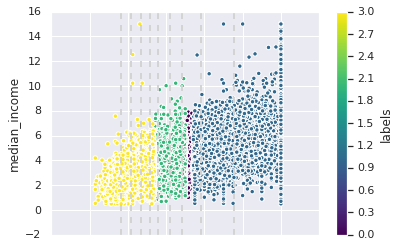

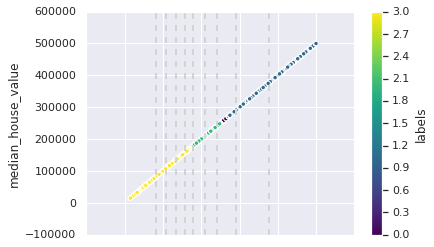

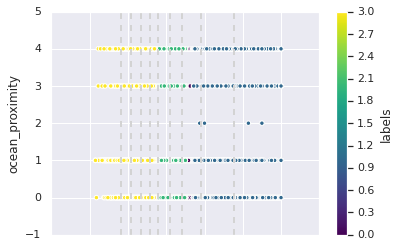

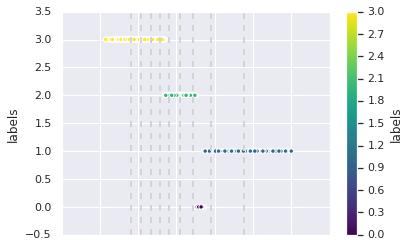

In [ ]:
Make_model(4,encoded_data1,2)

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


silhouette_score : 
-0.8688017065834495


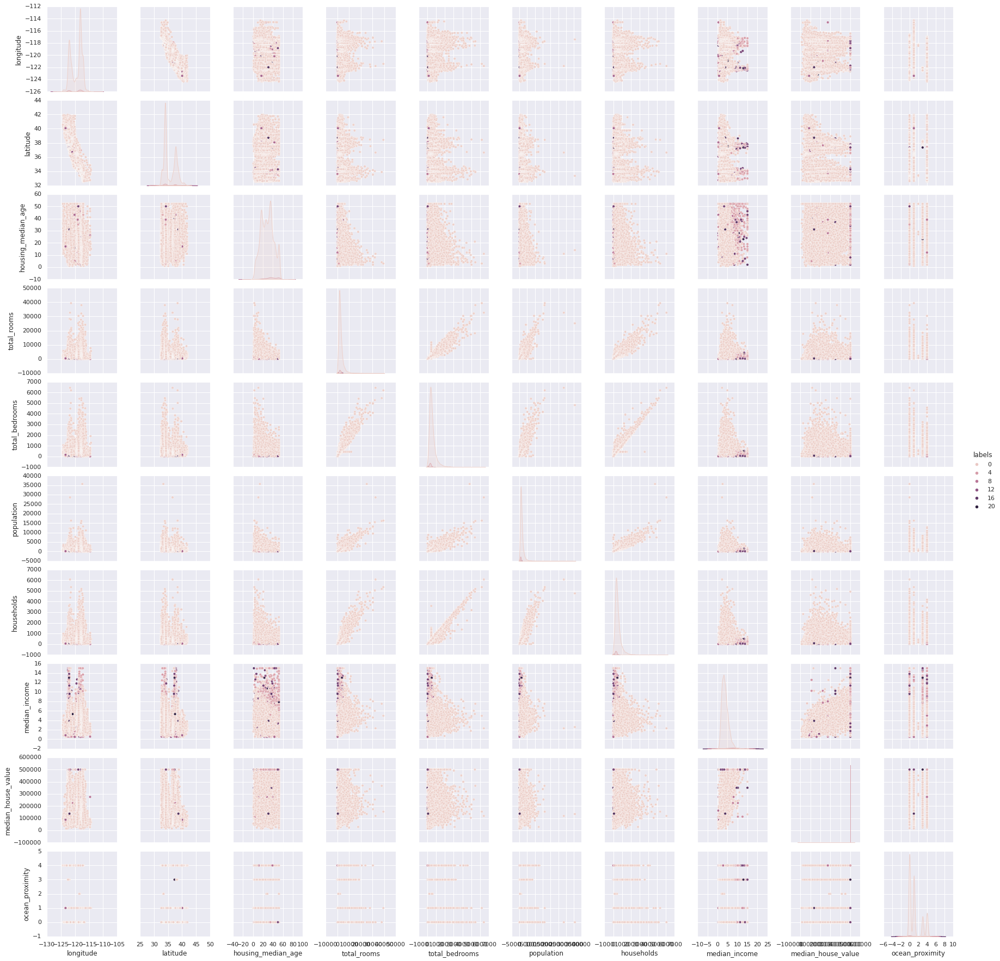

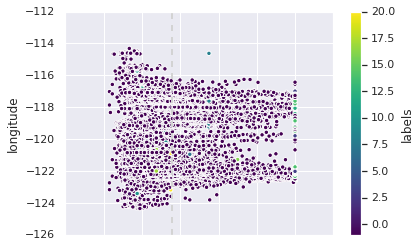

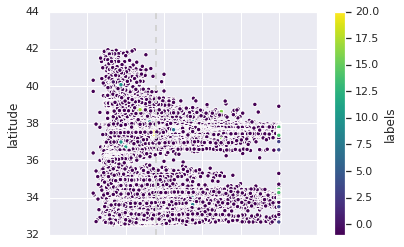

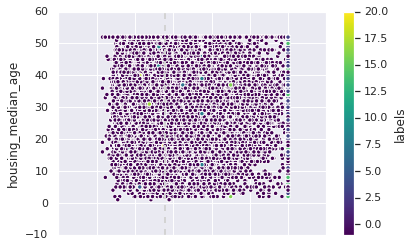

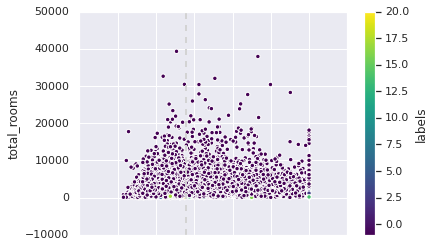

...

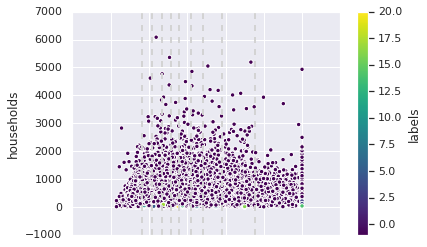

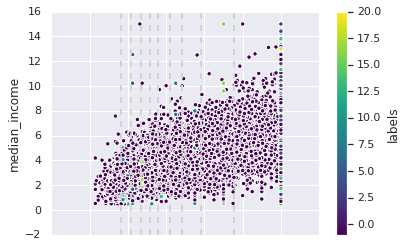

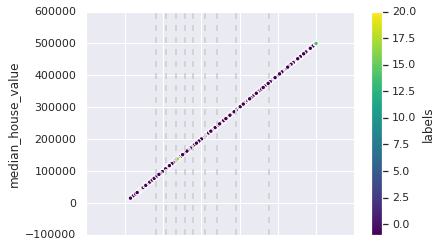

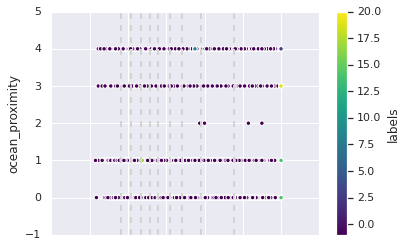

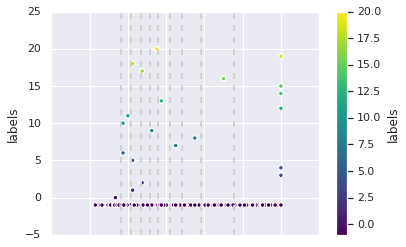

In [ ]:
Make_model(4,encoded_data1,3,eps=100.0)

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


silhouette_score : 
-0.12052414207753633


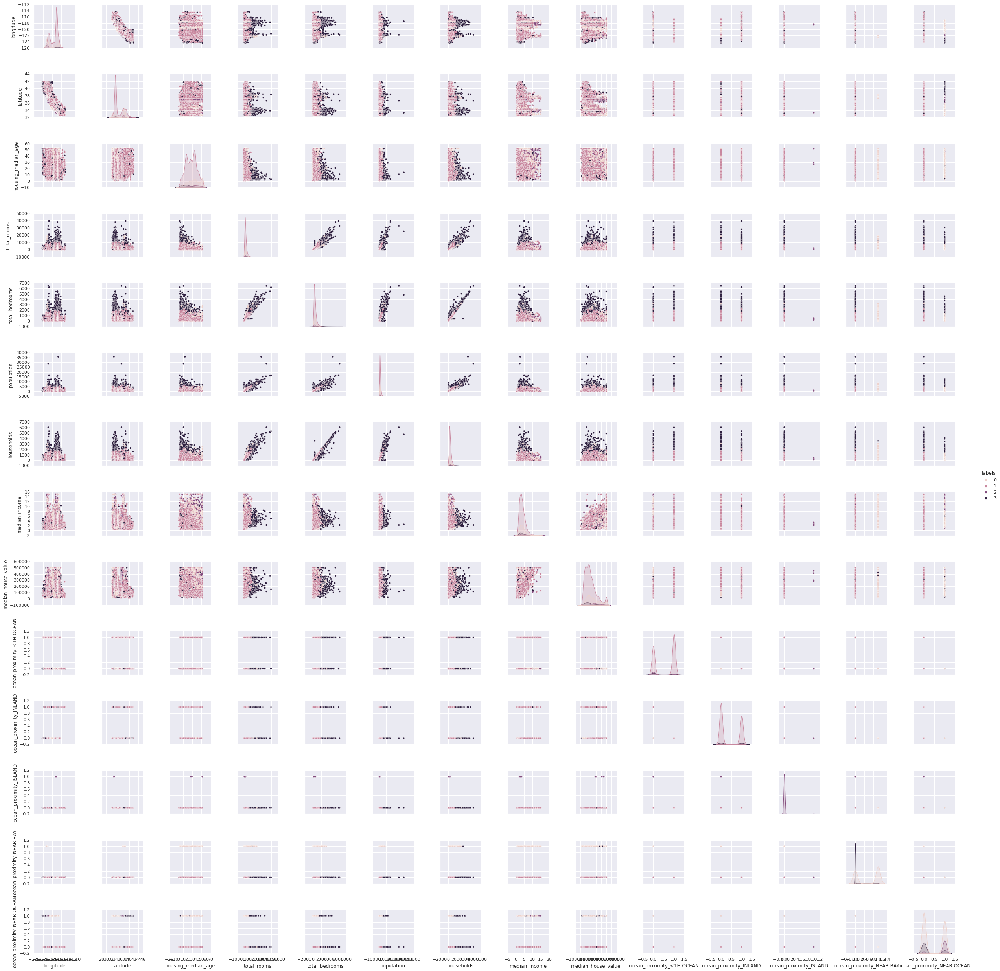

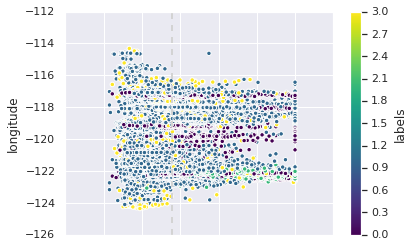

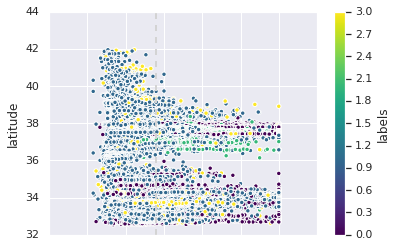

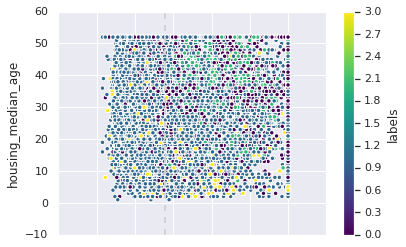

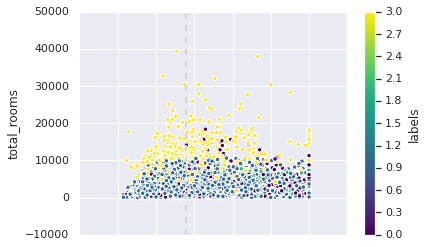

...

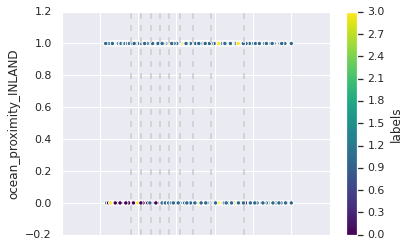

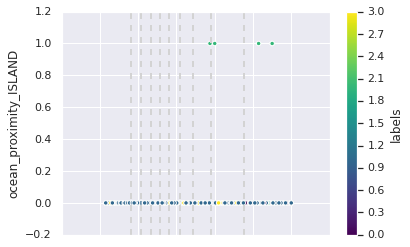

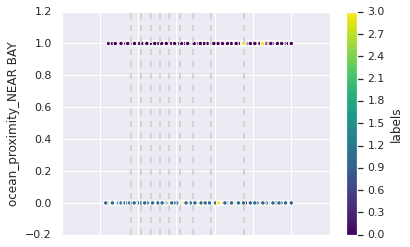

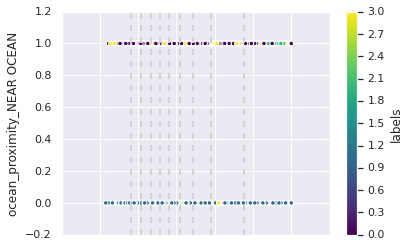

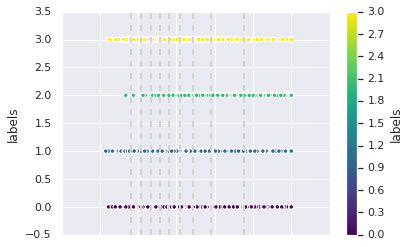

In [ ]:
Make_model(4,encoded_data2,1)

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


silhouette_score : 
0.5774185360399137


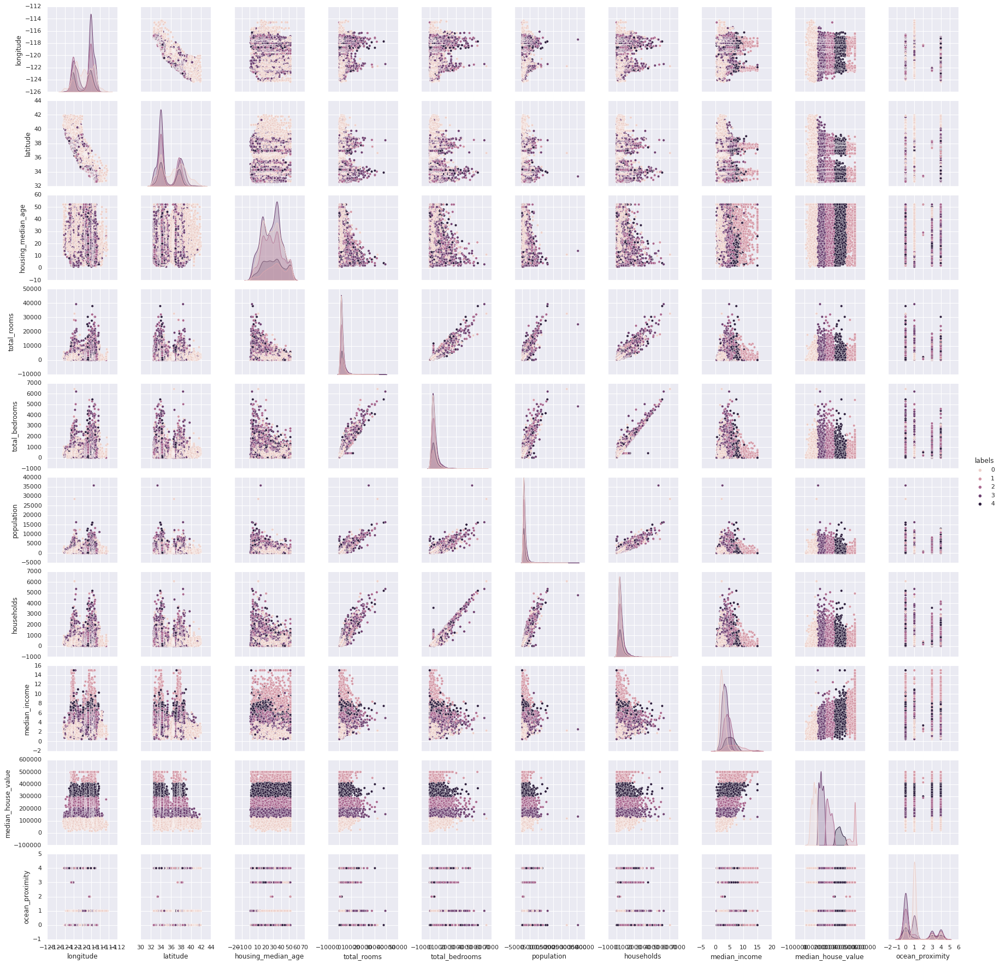

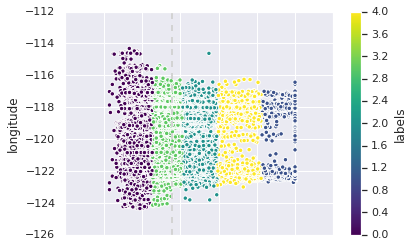

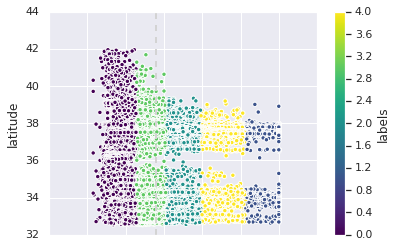

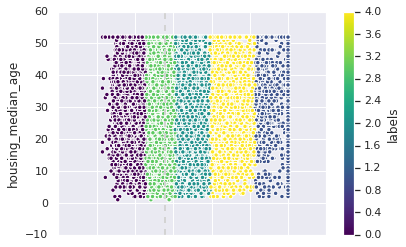

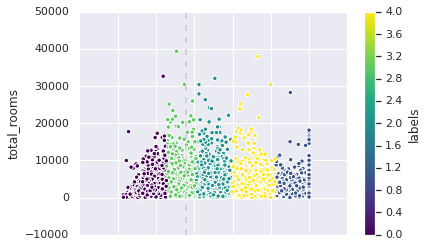

...

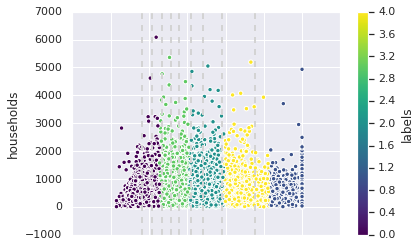

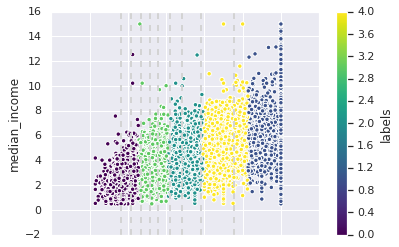

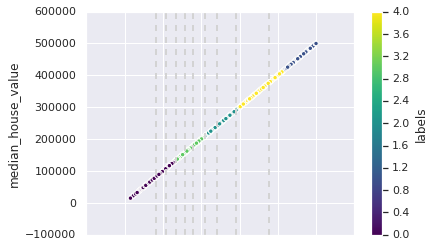

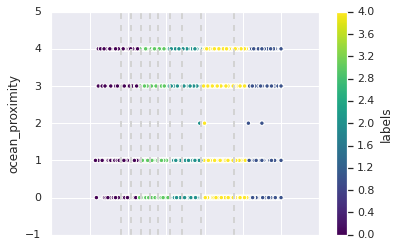

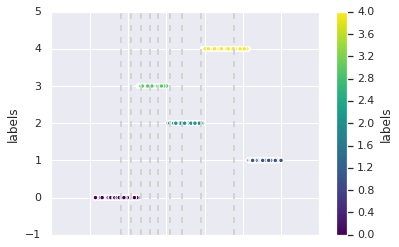

In [ ]:
Make_model(5,encoded_data1,0)

In [ ]:
def AutoML(K,data,e_case,s_case,m_case,**kwargs):
  
  # Call Cleander
  cleanded_data = Cleaning_data(data)

  # Call Encoder
  df1 = cleanded_data.copy()
  list1 = ['ocean_proximity']

  # Save encoded data
  encoded_data1 = Encoder(df1, e_case, list1)

  # Call Scaler
  Scaler(encoded_data1, s_case)

  Make_model(K,encoded_data1,m_case,kwargs)


(20640, 10)

 *** Original Dataset
   longitude  latitude  housing_median_age  total_rooms  total_bedrooms  \
0    -122.23     37.88                41.0        880.0           129.0   
1    -122.22     37.86                21.0       7099.0          1106.0   
2    -122.24     37.85                52.0       1467.0           190.0   
3    -122.25     37.85                52.0       1274.0           235.0   
4    -122.25     37.85                52.0       1627.0           280.0   

   population  households  median_income  median_house_value ocean_proximity  
0       322.0       126.0         8.3252            452600.0        NEAR BAY  
1      2401.0      1138.0         8.3014            358500.0        NEAR BAY  
2       496.0       177.0         7.2574            352100.0        NEAR BAY  
3       558.0       219.0         5.6431            341300.0        NEAR BAY  
4       565.0       259.0         3.8462            342200.0        NEAR BAY  

 *** The number of missing value
longit

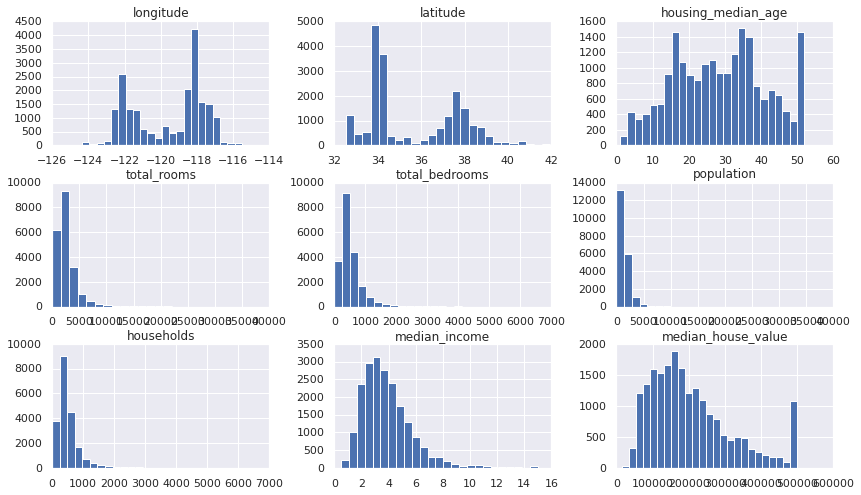


 *** After One Hot Encoding
   longitude  latitude  housing_median_age  total_rooms  total_bedrooms  \
0    -122.23     37.88                41.0        880.0           129.0   
1    -122.22     37.86                21.0       7099.0          1106.0   
2    -122.24     37.85                52.0       1467.0           190.0   
3    -122.25     37.85                52.0       1274.0           235.0   
4    -122.25     37.85                52.0       1627.0           280.0   

   population  households  median_income  median_house_value  \
0       322.0       126.0         8.3252            452600.0   
1      2401.0      1138.0         8.3014            358500.0   
2       496.0       177.0         7.2574            352100.0   
3       558.0       219.0         5.6431            341300.0   
4       565.0       259.0         3.8462            342200.0   

   ocean_proximity_<1H OCEAN  ocean_proximity_INLAND  ocean_proximity_ISLAND  \
0                        0.0                     0.0   

ValueError: ignored

In [ ]:
AutoML(4,data,3,1,0,random_state=10)